# Analysis Open Data 15-minutes cities 

In [1]:
# Libraries importation 
import geopandas as gpd
import pandas as pd
import osmnx as ox 
import seaborn as sns
import ast
import shapely
from geopandas.tools import sjoin
import numpy as np
import gtfs_functions as gtfs
import keplergl as kp
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

## 0. Delimitation of interest

In [2]:
# importation of both shapefile
subsector = gpd.read_file('Data/GG_sous_secteur/GG_sous_secteur/OCS_POPULATION_SSECTEUR.shp')
sector = gpd.read_file('Data/GG_typo/GG_typo/GGtypo.shp') 
sector_GE=sector[(sector.CANTON_DEP=="Genève")]
sector_GE.head(1)

,CANTON_DEP,COMMUNE,PAYS,NUMERO_CAN,NUMERO_COM,CODE_POSTA,SHAPE_AREA,SHAPE_LEN,D17,D4,departemen,communaute,TYPOLOGIE,ACTIF_FRGE,geometry
1,Genève,Bernex,SUISSE,25,6607,None,1.295422e+07,23206.6454,6,1,Canton de Geneve,Canton de Geneve,suburbain deuxieme couronne,N/A,"POLYGON ((2495959.838 1117673.908, 2495951.840..."


Text(0.5, 1.0, 'Sector')

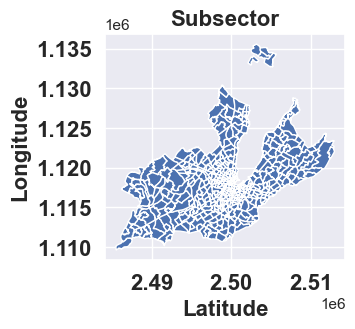

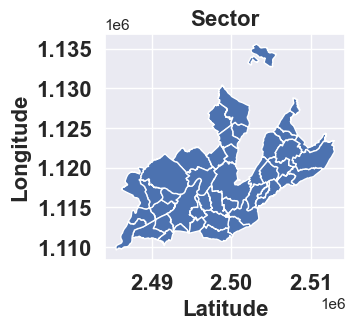

In [3]:
#plotting
plt.rcParams['figure.figsize'] = [15, 3]
plt.rcParams['figure.dpi'] = 100 # 200 e.g. is really fine, but slower
font = {'family' : 'DejaVu Sans',
        'weight' : 'bold',
        'size'   : 18}
sns.set_theme()

subsector["geometry"].plot()
plt.xticks(fontweight="bold",fontsize=16)
plt.yticks(fontweight="bold",fontsize=16)
plt.xlabel('Latitude',fontweight="bold",fontsize=16)
plt.ylabel('Longitude',fontweight="bold",fontsize=16)
plt.title('Subsector',fontweight="bold",fontsize=16)

sector_GE["geometry"].plot()
plt.xticks(fontweight="bold",fontsize=16)
plt.yticks(fontweight="bold",fontsize=16)
plt.xlabel('Latitude',fontweight="bold",fontsize=16)
plt.ylabel('Longitude',fontweight="bold",fontsize=16)
plt.title('Sector',fontweight="bold",fontsize=16)


How to choose? Assumptions:

* Bike : speed 12 km/hr
* Foot : 4.5 km/hr 

First we use shape lengh, which are given on m/linear

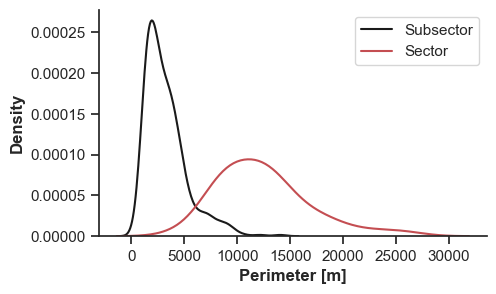

In [4]:
# comparison plot Perimeter
custom_params = {"axes.spines.right": False, "axes.spines.top": False}
sns.set_theme(style="ticks", rc=custom_params)
fig=plt.figure(figsize=(5,3))
sns.kdeplot(subsector.SHAPE_LEN,color="k")
sns.kdeplot(sector_GE.SHAPE_LEN,color="r")
plt.ylabel("Density",fontweight="bold")
plt.xlabel("Perimeter [m]",fontweight="bold")
plt.legend(["Subsector","Sector"])
plt.show()

fig.savefig("Figures/png/Perimeter",bbox_inches="tight")

Secondly, we use shape area, which are given on m2

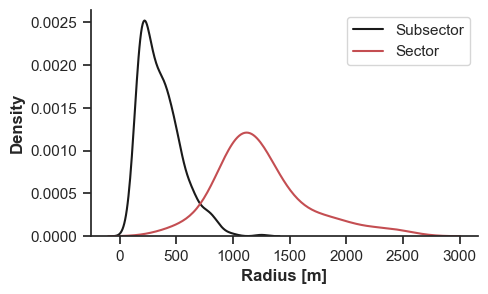

In [5]:
#comparison plot Area
fig=plt.figure(figsize=(5,3))
sns.kdeplot(np.sqrt(subsector.SHAPE_AREA/np.pi),color="k")
sns.kdeplot(np.sqrt(sector_GE.SHAPE_AREA/np.pi),color="r")
plt.ylabel("Density",fontweight="bold")
plt.xlabel("Radius [m]",fontweight="bold")
plt.legend(["Subsector","Sector"])
plt.show()
fig.savefig("Figures/png/Radius",bbox_inches="tight")

## 1. Data importation

### 1.1 Sub sectors

In [6]:
# sub-sector importation and transformation into the right crs
sous_sect = gpd.read_file('Data/geojson/sous_secteur.geojson')
sous_sect.crs="EPSG:2056"
ss=sous_sect[['NOM_SSECTE','NOM_SECTEU','POP','SHAPE_AREA','geometry']]
ss=ss.to_crs(4326)
ss.head(1)

,NOM_SSECTE,NOM_SECTEU,POP,SHAPE_AREA,geometry
0,La Petite-Boisière,Florissant - Malagnou,1172,140443.39415,"POLYGON ((6.16607 46.19628, 6.16618 46.19642, ..."


### 1.2 Open street map data

First, we define the different group of interest (GOI) and use the wikipedia of the tags to have a reference of our choice:

* https://wiki.openstreetmap.org/wiki/Key:highway

* https://wiki.openstreetmap.org/wiki/Key:amenity

The GOI that have been choice are :
* entertainment_arts_culture
* leisure
* sustenance
* transportation
* tourism
* leisure

In [7]:
# groups definition
entertainment_arts_culture=['arts_centre','casino','cinema','community_centre','conference_centre','fountain','nightclub','planetarium','social_centre','studio','theatre']
education=['college','kindergarten','language_school','library','toy_library','music_school','school','university']
health=['clinic','dentist','doctors','hospital','nursing_home','pharmacy','social_facility','veterinary']
sustenance=['bar','biergarten','cafe','fast_food','food_court','ice_cream','pub','restaurant']
transportation=['bicycle_parking','bicycle_repair_station','bus_station','car_sharing','charging_station','	ferry_terminal','motorcycle_parking','parking','taxi']
road=['motorway','trunk','primary','secondary','tertiary','unclassified','residential']
road_link=['motorway_link','trunk_link','primary_link','secondary_link','tertiary_link']
network_n=road+road_link
tourism=['viewpoint','picnic_site','guest_house','museum','hotel','attraction','gallery','hostel','motel']
leisure=['swimming_pool','park','playground','sports_centre','fitness_centre','dog_park','recreation_ground']
amenity=entertainment_arts_culture+education+health+sustenance
highway=road+road_link+['busway','cycleway','bus_stop','footway','pedestrian','path']

Then we import the tag of interest:

In [9]:
tags_of_interest= {'amenity' : amenity,
                   'shop' : ['water','bakery''convenience','supermarket','clothes','hairdresser','kiosk','mall','florist','art','outdoor','boutique'],
                   'tourism' : tourism,
                   'highway' : highway,
                   'railway' :['tram_stop'],
                   'public_transport':['stop_position'],
                  'leisure': leisure}

In [10]:
# import from Geneva on a distance of 20 km 
point = (46.20222, 6.14569)
dist = 20000
osm_data = ox.geometries.geometries_from_point(point,tags_of_interest,dist=dist)
osm_data_save=osm_data.applymap(lambda x: str(x) if isinstance(x, list) else x)
osm_data_clean=osm_data_save.reset_index()[['amenity','shop','tourism','highway','natural','leisure',\
                                            'name','geometry','railway','public_transport']]

### 1.3 GTFS data

In [11]:
#import gtfs data
FILE="Data/Folder_2022_03_22_15_50_archive.zip"
routes_gtfs, stops_gtfs, stop_times_gtfs, trips_gtfs, shapes = gtfs.import_gtfs(FILE)
display(stop_times_gtfs.head(2))

,trip_id,arrival_time,departure_time,stop_id,stop_sequence,pickup_type,drop_off_type,shape_dist_traveled,route_id,service_id,direction_id,shape_id,stop_name,location_type,parent_station,geometry
0,19.TA.91-16-j22-1.5.H,71460.0,71460.0,8588776,1,0,0,0.000000,91-16-j22-1,TA+b7c20,0,6362,"Basel, MParc",NaN,NaN,POINT (7.60658 47.53879)
1,19.TA.91-16-j22-1.5.H,71520.0,71520.0,8588778,2,0,0,0.717253,91-16-j22-1,TA+b7c20,0,6362,"Basel, Münchensteinerstrasse",NaN,NaN,POINT (7.59950 47.54311)


## 2. Service avaibility and popularity factors

In [12]:
# Keep only the Osm Data in the Subsector and merge each data to his subsector
osm_data_ss = gpd.clip(osm_data_clean,ss)

In [13]:
# We can now merge the data with the subsector:
osm_data_final_ss=sjoin(osm_data_ss,ss,how="right")

As described in the report, we can regroup the tags into two axes:
* popularity 
* services avaibility

Then, we count the number of tag by sub-sector.

In [14]:
#form our axes
popularity = entertainment_arts_culture+sustenance+tourism
services = leisure+health+education
osm_data_final_ss["popularity"]= np.where(osm_data_final_ss.amenity.isin(popularity), 1, 0)
osm_data_final_ss["services"]= np.where(osm_data_final_ss.amenity.isin(services), 1, 0)

In [15]:
#finalise the count and merge with the sub-sectors
osm_data_by_group=osm_data_final_ss.groupby(["NOM_SSECTE","SHAPE_AREA"]).sum().drop("index_left",axis=1).reset_index()
osm_data_by_group=osm_data_by_group.merge(ss[["NOM_SSECTE","geometry"]],on="NOM_SSECTE" )

In [16]:
osm_data_by_group.head(3)

,NOM_SSECTE,SHAPE_AREA,POP,popularity,services,geometry
0,ANSERMET,124960.79655,123570,6,10,"POLYGON ((6.13082 46.19808, 6.13300 46.19961, ..."
1,APPIA,168927.79675,535,1,0,"POLYGON ((6.12986 46.22965, 6.12989 46.22972, ..."
2,Acacias-Etoile,195310.47860,611643,10,7,"POLYGON ((6.12764 46.18738, 6.12764 46.18757, ..."


In [17]:
#normalise the df
osm_data_by_group.loc[:,"SHAPE_AREA":"services"]=osm_data_by_group.loc[:,"SHAPE_AREA":"services"]/osm_data_by_group.loc[:,"SHAPE_AREA":"services"].max(axis=0)
osm_data_by_group_normalised=osm_data_by_group.copy()

In [18]:
# factors calculation
f_popul=osm_data_by_group_normalised.popularity/np.sqrt(osm_data_by_group_normalised.SHAPE_AREA)
f_service=osm_data_by_group_normalised.services/np.sqrt(osm_data_by_group_normalised.SHAPE_AREA)

In [19]:
osm_data_by_group["f_popul"]=f_popul
osm_data_by_group["f_service"]=f_service

In [20]:
#save on a copy to not modify the geometry when plotting and remove unnecessary columns
osm_data_by_group=osm_data_by_group.drop(["popularity","services"],axis=1)
osm_data_popularity=osm_data_by_group.copy()
# normalise again to shows what is summed when computing Urban Vitality
osm_data_popularity.f_popul=osm_data_popularity.f_popul/osm_data_popularity.f_popul.max()
osm_data_popularity.head(3)

,NOM_SSECTE,SHAPE_AREA,POP,geometry,f_popul,f_service
0,ANSERMET,0.025419,0.032917,"POLYGON ((6.13082 46.19808, 6.13300 46.19961, ...",0.126884,4.824801
1,APPIA,0.034362,0.000143,"POLYGON ((6.12986 46.22965, 6.12989 46.22972, ...",0.018188,0.000000
2,Acacias-Etoile,0.039729,0.162933,"POLYGON ((6.12764 46.18738, 6.12764 46.18757, ...",0.169153,2.701479


In [21]:
#plot popularity
config_pop = np.load('Data/Kepler_config/popularity.npy',allow_pickle='TRUE').item()
osm_data_popularity_gpd = gpd.GeoDataFrame(osm_data_popularity, geometry=osm_data_popularity.geometry)
kepler_map = kp.KeplerGl(height=800)
kepler_map.add_data(data = osm_data_popularity_gpd,name="osm_data_by_group")
kepler_map.config = config_pop
kepler_map

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter


KeplerGl(config={'version': 'v1', 'config': {'visState': {'filters': [], 'layers': [{'id': '9zzsyn', 'type': '…

In [23]:
# same for services availability
osm_data_service=osm_data_by_group.copy()
# normalise again to shows what is summed when computing Urban Vitality
osm_data_service.f_service=osm_data_service.f_service/osm_data_service.f_service.max()
osm_data_service.head(3)

,NOM_SSECTE,SHAPE_AREA,POP,geometry,f_popul,f_service
0,ANSERMET,0.025419,0.032917,"POLYGON ((6.13082 46.19808, 6.13300 46.19961, ...",0.896035,1.000000
1,APPIA,0.034362,0.000143,"POLYGON ((6.12986 46.22965, 6.12989 46.22972, ...",0.128443,0.000000
2,Acacias-Etoile,0.039729,0.162933,"POLYGON ((6.12764 46.18738, 6.12764 46.18757, ...",1.194532,0.559915


In [24]:
#plot services availability 
config_serv = np.load('Data/Kepler_config/service.npy',allow_pickle='TRUE').item()
osm_data_service_gpd = gpd.GeoDataFrame(osm_data_service, geometry=osm_data_service.geometry)
kepler_map = kp.KeplerGl(height=800)
kepler_map.add_data(data = osm_data_service_gpd ,name="osm_data_by_group")
kepler_map.config = config_serv
kepler_map

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter


KeplerGl(config={'version': 'v1', 'config': {'visState': {'filters': [], 'layers': [{'id': '9zzsyn', 'type': '…

## 3: Treatment of the transportation information (OSM)

In [26]:
# sub-sector importation to have to unmodified dataset of subsector
sous_sect = gpd.read_file('Data/geojson/sous_secteur.geojson')
sous_sect.crs="EPSG:2056"
ss=sous_sect[['NOM_SSECTE','NOM_SECTEU','POP','SHAPE_AREA','geometry']]
ss=ss.to_crs(4326)
ss.head(1)

,NOM_SSECTE,NOM_SECTEU,POP,SHAPE_AREA,geometry
0,La Petite-Boisière,Florissant - Malagnou,1172,140443.39415,"POLYGON ((6.16607 46.19628, 6.16618 46.19642, ..."


### 3.1:Parking analysis

This part of the code doesn't give any result because it is very difficult to understand the logic behind the collect of the data. Indeed, we have some parking place indicate by points and other by polygons. Note that the following result are not presented in the report.

In [27]:
#extract only transportation related data from OSM and then clip and join again to the subsector as done with all the data before
osm_data_tranportation=ox.geometries.geometries_from_point(point,{'amenity' : transportation},dist=dist)

In [28]:
# cleaning
osm_data_tranportation_=osm_data_tranportation.applymap(lambda x: str(x) if isinstance(x, list) else x)
osm_data_tranportation_clean=osm_data_tranportation_.reset_index()[['osmid','amenity','name','geometry']]

In [29]:
#clip
osm_data_tranportation_ss=gpd.clip(osm_data_tranportation_clean,ss)

We add the area of the parking to the dataset:

In [30]:
# modif in the crs in order to correctly extract the area of the parking place
osm_data_tranportation_ss.crs=4326
osm_data_tranportation_ss = osm_data_tranportation_ss.to_crs({'proj':'cea'}) 
osm_data_tranportation_ss['area']=osm_data_tranportation_ss.area

In [31]:
# modify back the crs to be able to plot
osm_data_tranportation_ss = osm_data_tranportation_ss.to_crs(4326) 

In [32]:
#join
osm_data_final_ss_transport=sjoin(osm_data_tranportation_ss,ss,how="right")
osm_data_final_ss_transport.head(3)

,index_left,osmid,amenity,name,area,NOM_SSECTE,NOM_SECTEU,POP,SHAPE_AREA,geometry
0,NaN,NaN,NaN,NaN,NaN,La Petite-Boisière,Florissant - Malagnou,1172,140443.39415,"POLYGON ((6.16607 46.19628, 6.16618 46.19642, ..."
1,2639.0,199912059.0,parking,NaN,231.595569,La Florence,Florissant - Malagnou,3541,242334.70810,"POLYGON ((6.16403 46.19237, 6.16473 46.19303, ..."
1,2638.0,199912057.0,parking,NaN,266.906833,La Florence,Florissant - Malagnou,3541,242334.70810,"POLYGON ((6.16403 46.19237, 6.16473 46.19303, ..."


In [33]:
# map show that it is not worthit to continue this analysis
map_by_ = kp.KeplerGl(height=600)
map_by_.add_data(data=osm_data_tranportation_ss,name="om")
map_by_

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter


C:\Users\41789\anaconda3\envs\ox\lib\site-packages\jupyter_client\session.py:716: UserWarning: Message serialization failed with:
Out of range float values are not JSON compliant
Supporting this message is deprecated in jupyter-client 7, please make sure your message is JSON-compliant
  content = self.pack(content)


KeplerGl(data={'om': {'index': [3990, 2311, 3680, 3678, 3679, 3677, 656, 1502, 3729, 2335, 3733, 7184, 7185, 7…

### 3.2: Study of bus_stop

#### *OSM*

In [34]:
# get the stops detected by open street map 
stops_GE=osm_data_ss[osm_data_ss.public_transport=='stop_position']
#number of bus stop before cleaning
stops_GE.shape

(1598, 10)

In [35]:
#cleaning
stops_osm=stops_GE.groupby("name").head(1).reset_index(drop=True).loc[:,'name':'geometry']

In [96]:
#number of bus stop after cleaning
stops_osm.shape

(764, 3)

In [36]:
# We apply a buffer in order to compare with the gtfs datas
stops_osm.crs=4326
stops_osm = stops_osm.to_crs({'proj':'cea'})  #Pick another
stops_osm['geometry'] = stops_osm['geometry'].buffer(50)
stops_osm['area']=stops_osm.geometry.area
stops_osm =stops_osm.to_crs(4326)

In [37]:
stops_osm.head(3)

,name,geometry,area
0,Monniaz-Hameau,"POLYGON ((6.30654 46.24177, 6.30654 46.24170, ...",7841.371226
1,Châtaignières,"POLYGON ((6.29666 46.24146, 6.29665 46.24140, ...",7841.371226
2,Petit-Lullier,"POLYGON ((6.26834 46.23291, 6.26834 46.23285, ...",7841.371226


In [38]:
# Aera of the buffer (buffer check) --> ok
np.pi*50**2

7853.981633974483

#### *GTFS*

In [40]:
# make sure it is in the right crs
stops_gtfs=stops_gtfs.to_crs(4326)

In [41]:
#clip
stops_GE_gtfs=gpd.clip(stops_gtfs,ss)
stops_GE_gtfs.head(2)

,stop_id,stop_name,location_type,parent_station,geometry
32675,8595670,"Sauverny, douane",NaN,NaN,POINT (6.12047 46.31138)
32676,8595671,"Sauverny, Martinet",NaN,NaN,POINT (6.12364 46.31432)


In [42]:
# number of bus detected in the buffer
stops_GE_gtfs.stop_name.shape

(792,)

We can then calculate the similarity ratio

In [43]:
# clip the bus stop from gtfs in the buffer in osm data
similarity=gpd.clip(stops_GE_gtfs,stops_osm,keep_geom_type=True)
# precision ratio
similarity.shape[0]/stops_GE_gtfs.shape[0]

0.8484848484848485

### 3.3: Accessibility factor

In [44]:
# calcul of the frequency
cutoffs = [0,24]
stop_freq = gtfs.stops_freq(stop_times_gtfs, stops_gtfs, cutoffs = cutoffs)
stop_freq.crs=4326
#clip on sub-sectors
stop_freq_ge=gpd.clip(stop_freq,ss)
stop_freq_ge.head(5)

,stop_id,dir_id,window,ntrips,frequency,max_trips,max_freq,stop_name,geometry
50384,8588665,Outbound,0:00-24:00,34,42,2,30,"Céligny, gare",POINT (6.19965 46.34812)
50383,8588665,Inbound,0:00-24:00,39,36,2,30,"Céligny, gare",POINT (6.19965 46.34812)
50381,8588664,Inbound,0:00-24:00,39,36,2,30,"Céligny, village",POINT (6.19568 46.35100)
50382,8588664,Outbound,0:00-24:00,34,42,2,30,"Céligny, village",POINT (6.19568 46.35100)
48076,8587044,Outbound,0:00-24:00,39,36,4,15,"Collex, centre",POINT (6.12234 46.27003)


In [45]:
# get only the trip comming in 
inbound=stop_freq_ge[stop_freq_ge.dir_id=="Inbound"]
#join the stop to the subsectors
inbound_stop=sjoin(inbound,ss,how="right")

In [46]:
#accessibility ration calculation
accessibility=inbound_stop.groupby(['NOM_SSECTE','SHAPE_AREA']).agg({'ntrips':'count','frequency':'mean'}\
                                                                   ).reset_index(1).rename({"ntrips":"nstops"\
                                                                                           },axis=1)
#normalize 
accessibility_normalized=accessibility/accessibility.max(axis=0)
accessibility_normalized["f_a"]=accessibility_normalized.nstops*accessibility_normalized.frequency/accessibility_normalized.SHAPE_AREA
# NaN as no access (data cleaning)
accessibility_normalized=accessibility_normalized.fillna(0)
# merge on sub-sectors
accessibility_normalized_ss=accessibility_normalized.reset_index().merge(ss,on='NOM_SSECTE')

In [47]:
# normalise again to shows what is summed when computing Urban Vitality# normalise again to shows what is summed when computing Urban Vitality
accessibility_normalized_ss.f_a=accessibility_normalized_ss.f_a/accessibility_normalized_ss.f_a.max()
accessibility_normalized_ss.sample(5)

,NOM_SSECTE,SHAPE_AREA_x,nstops,frequency,f_a,NOM_SECTEU,POP,SHAPE_AREA_y,geometry
100,Conches-La Petite-Paumière,0.073055,0.1,0.016433,0.000958,None,567,359144.42185,"POLYGON ((6.17109 46.19060, 6.17156 46.19044, ..."
282,Les Semailles,0.040781,0.3,0.015216,0.004768,None,1949,200482.65610,"POLYGON ((6.11652 46.17710, 6.11652 46.17716, ..."
210,La Praille-Rte des Jeunes,0.024915,0.1,0.005478,0.000937,None,4,122482.11225,"POLYGON ((6.13136 46.17699, 6.13136 46.17690, ..."
279,Les Philosophes,0.018838,0.0,0.000000,0.000000,La Cluse - Philosophes,3254,92610.61400,"POLYGON ((6.14170 46.19506, 6.14177 46.19516, ..."
474,ZIPLO,0.144276,0.6,0.030736,0.005445,None,69,709275.35545,"POLYGON ((6.09740 46.16587, 6.09752 46.16594, ..."


In [93]:
#plot accesibility factor
config_access=np.load('Data/Kepler_config/accessibility.npy',allow_pickle='TRUE').item()
accessibility_normalized_ss_gpd = gpd.GeoDataFrame(accessibility_normalized_ss, geometry=accessibility_normalized_ss.geometry)
kepler_map = kp.KeplerGl(height=800)
kepler_map.add_data(data=accessibility_normalized_ss_gpd ,name="osm_data_by_group")
kepler_map.config = config_access
kepler_map


User Guide: https://docs.kepler.gl/docs/keplergl-jupyter


KeplerGl(config={'version': 'v1', 'config': {'visState': {'filters': [], 'layers': [{'id': 'apdy45r', 'type': …

##  4. Offer Ratio

In [50]:
# sub-sector importation to have to unmodified dataset of subsector
sous_sect = gpd.read_file('Data/geojson/sous_secteur.geojson')
ss=sous_sect[['NOM_SSECTE','NOM_SECTEU','POP', 'geometry']]
ss=ss.to_crs(4326)
ss.head(1)

,NOM_SSECTE,NOM_SECTEU,POP,geometry
0,La Petite-Boisière,Florissant - Malagnou,1172,"POLYGON ((2501766.67000 1116889.55000, 2501775..."


In [51]:
def tag_accessibility(geometry,mask,osm_data_ss):
    '''
    Input:  the geometry of a point: where the buffer will be apply from 
            a mask : to sort the desired tags
            a dataset (osm_data_ss)
    Output: a dataset with the number of each desired tags detected in the buffer of 1125 m
    
    '''
    # apply a buffer to the point
    geometry.name="geometry"
    random_point=g.reset_index()
    random_point=gpd.GeoDataFrame(random_point,geometry="geometry")
    random_point.crs="EPSG:2056"
    random_point["geometry"] = random_point["geometry"].buffer(1125)
    random_point=random_point.to_crs(4326)
    #get the mask on the osmdata 
    osm_data_needs=osm_data_ss[mask]
    osm_data_needs["entertainment_arts_culture"]= np.where(osm_data_needs.amenity.isin(entertainment_arts_culture), 1, 0)
    osm_data_needs["education"]= np.where(osm_data_needs.amenity.isin(education), 1, 0)
    osm_data_needs["health"]= np.where(osm_data_needs.amenity.isin(health), 1, 0)
    osm_data_needs["sustenance"]= np.where(osm_data_needs.amenity.isin(sustenance), 1, 0)
    osm_data_needs["leisure_"]= np.where(osm_data_needs.leisure.isin(leisure), 1, 0)
    osm_data_needs["tourism_"]= np.where(osm_data_needs.tourism.isin(tourism), 1, 0)
    #clipped
    osm_data_needs_clipped=gpd.clip(osm_data_needs,random_point.geometry)
    #join
    access=sjoin(osm_data_needs_clipped,random_point,how="left")
    access_ss=access.groupby(['NOM_SSECTE']).sum()
    return access_ss.loc[:,"entertainment_arts_culture":"tourism_"]

In [52]:
from shapely.geometry import Point

def random_point_in_shp(shp):
    ''' Function wich detect points
    Input: shp file
    Output : a Point geometry
    '''
    within = False
    while not within:
        x = np.random.uniform(shp.bounds[0], shp.bounds[2])
        y = np.random.uniform(shp.bounds[1], shp.bounds[3])
        within = shp.contains(Point(x, y))
    return Point(x,y)


Source : https://stackoverflow.com/questions/58802921/using-geopandas-how-to-randomly-select-in-each-polygon-5-points-by-sampling-met

In [53]:
# create 50 pount geometry
for num in range(50):
    ss['geometry{}'.format(num)] = ss['geometry'].apply(random_point_in_shp)

In [54]:
# defin the mask
mask=osm_data_ss.amenity.isin(entertainment_arts_culture)|osm_data_ss.amenity.isin(education)|osm_data_ss.amenity.isin(health)|osm_data_ss.amenity.isin(sustenance)|osm_data_ss.leisure.isin(leisure)|osm_data_ss.tourism.isin(tourism)

Moreover we already estimate that we can do 1125 m after walking 15 min and 3000 m by biking 15 min 
Source: https://gis.stackexchange.com/questions/423100/%d0%a1reating-buffer-in-meters-using-geopandas

In [55]:
# compute all dataset and the calcul the average
random_point=ss.set_index("NOM_SSECTE").loc[:,"geometry0"::].T
# calcul the access at all group for the point choose radomly in a buffer 
columns=['entertainment_arts_culture', 'education', 'health', 'sustenance','leisure_', 'tourism_']
access_sum= pd.DataFrame(columns=columns,index=ss['NOM_SSECTE'],data=0,dtype="int64")
count=0
for n,geom in random_point.iterrows():
    g=geom
    access=tag_accessibility(geom,mask,osm_data_ss)
    if count<1:
        display(access)
    access_sum+=access
    count+=1
    
access_mean=access_sum/count

,entertainment_arts_culture,education,health,sustenance,leisure_,tourism_
NOM_SSECTE,,,,,,
ANSERMET,76,54,31,296,122,37
APPIA,100,23,7,38,101,13
Acacias-Etoile,31,38,26,148,142,8
Adrien-JEANDIN,7,14,17,15,160,0
Anières-Hutins,3,2,1,5,127,2
...,...,...,...,...,...,...
ZIMEYSA-Montfleury,9,5,9,17,42,3
ZIMEYSA-Moulières,1,1,1,9,16,0
ZIMEYSA-Pré-Bouvier,3,3,4,23,25,4


In [56]:
# clean and merge with sub-sectors
column = ['NOM_SSECTE','entertainment_arts_culture', 'education', 'health','sustenance', 'leisure_', 'tourism_','geometry']
access_ss = access_mean.merge(ss,on=access_mean.index)[column]
# ready to plot
access_mean = gpd.GeoDataFrame(access_ss,geometry = access_ss["geometry"], crs = 2056)
access_mean = access_mean.to_crs(4326)
access_mean.head(3)

,NOM_SSECTE,entertainment_arts_culture,education,health,sustenance,leisure_,tourism_,geometry
0,La Petite-Boisière,14.40,37.52,26.12,62.50,143.18,5.70,"POLYGON ((6.16607 46.19628, 6.16618 46.19642, ..."
1,La Florence,10.08,34.98,21.54,41.80,154.12,5.64,"POLYGON ((6.16403 46.19237, 6.16473 46.19303, ..."
2,Eugène-PITTARD,8.80,33.44,22.68,34.86,133.76,7.60,"POLYGON ((6.16285 46.19130, 6.16295 46.19138, ..."


In [57]:
# calcul the supply ratio
access_mean["offer_ratio"]=access_mean.entertainment_arts_culture / access_mean.entertainment_arts_culture.max()\
                            + access_mean.education / access_mean.education.max()\
                            + access_mean.health / access_mean.health.max()\
                            + access_mean.sustenance / access_mean.sustenance.max()\
                            + access_mean.leisure_ / access_mean.leisure_.max()\
                            + access_mean.tourism_ / access_mean.tourism_.max()

In [58]:
# plot the supply ratio
config_offer=np.load('Data/Kepler_config/offer.npy',allow_pickle='TRUE').item()
kepler_map = kp.KeplerGl(height=800)
access_mean_gpd = gpd.GeoDataFrame(access_mean, geometry=access_mean.geometry)
kepler_map.add_data(data=access_mean_gpd ,name="access_mean")
kepler_map.config = config_offer
kepler_map

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter


KeplerGl(config={'version': 'v1', 'config': {'visState': {'filters': [], 'layers': [{'id': 'ztuykf5', 'type': …

## 5. Security factor

Note that all the graph are computed in the notebook "network.ipynb"

In [60]:
#save on a copy to not modify the geometry when plotting 
osm_data_by_secu=osm_data_by_group.copy()

In [61]:
#import the network save from the file network.ipynb
ss["walkLength"]=ss.apply(lambda x: ox.stats.edge_length_total(ox.load_graphml('Graphs/walk_graph_ss{}.graphml'.format(x.name))), axis=1)
ss["bikeLength"]=ss.apply(lambda x: ox.stats.edge_length_total(ox.load_graphml('Graphs/bike_graph_ss{}.graphml'.format(x.name))), axis=1)
ss["allLength"]=ss.apply(lambda x: ox.stats.edge_length_total(ox.load_graphml('Graphs/all_graph_ss{}.graphml'.format(x.name))), axis=1)
ss["rel_walk_length"]=ss.walkLength/ss.allLength
ss["rel_bike_length"]=ss.bikeLength/ss.allLength
ss["f_secu"]=ss["rel_walk_length"]*ss["rel_bike_length"]

In [62]:
# sort the subsectors after importing the f_secu
ss_sorted=ss.sort_values(by="NOM_SSECTE",ignore_index=True)

In [63]:
# add the f_secu to the other dataset
osm_data_by_secu["f_secu"]=ss_sorted.f_secu
osm_data_by_secu["f_secu"].head(3)

0    0.425665
1    0.348546
2    0.470490
Name: f_secu, dtype: float64

In [64]:
# normalise again to shows what is summed when computing Urban Vitality
osm_data_by_secu.f_secu=osm_data_by_secu.f_secu/osm_data_by_secu.f_secu.max()

In [89]:
# plot security factor
config_secu=np.load('Data/Kepler_config/secu.npy',allow_pickle='TRUE').item()
osm_data_secu_gpd = gpd.GeoDataFrame(osm_data_by_secu, geometry=osm_data_by_secu.geometry)
kepler_map = kp.KeplerGl(height=800)
kepler_map.add_data(data=osm_data_secu_gpd ,name="osm_data_by_group")
kepler_map.config = config_secu
kepler_map

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter


KeplerGl(config={'version': 'v1', 'config': {'visState': {'filters': [], 'layers': [{'id': 'q83v6we', 'type': …

## 6. Urban vitality factor

In [67]:
# add all the factors to calculate the Urban vitality 
osm_data_by_group["f_secu"]=ss_sorted["f_secu"]
osm_data_by_group["f_a"]=accessibility_normalized.f_a.values

In [69]:
osm_data_by_group["urban_vitality"]=osm_data_by_group.f_popul/osm_data_by_group.f_popul.max()+osm_data_by_group.f_secu/osm_data_by_group.f_secu.max()+osm_data_by_group.f_service/osm_data_by_group.f_service.max()+osm_data_by_group.f_a/osm_data_by_group.f_a.max()

In [70]:
#save on a copy to not modify the geometry when plotting
osm_data_uv=osm_data_by_group.copy()

In [71]:
#plot Urban Vitality
config_uv=np.load('Data/Kepler_config/urban_vitality.npy',allow_pickle='TRUE').item()
kepler_map = kp.KeplerGl(height=800)
osm_data_uv_gpd = gpd.GeoDataFrame(osm_data_uv, geometry=osm_data_uv.geometry)
kepler_map.add_data(data=osm_data_uv_gpd ,name="osm_data_by_group")
kepler_map.config = config_uv
kepler_map

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter


KeplerGl(config={'version': 'v1', 'config': {'visState': {'filters': [], 'layers': [{'id': 'q83v6we', 'type': …

## 7. Analysis of the different factors and the city center

In [73]:
# calculate the Centroid of each subsector
osm_data_by_group["centroid"]=osm_data_by_group.geometry.centroid

In [74]:
# location of geneva train station 
GE_station=shapely.geometry.Point(6.142616,46.210211)

In [75]:
osm_data_by_group["GE_Station"]=GE_station

In [76]:
osm_data_by_group=osm_data_by_group.set_geometry("GE_Station")

In [77]:
# change crs to have a accurate distance in meter
osm_data_by_group["GE_Station"]=osm_data_by_group["GE_Station"].to_crs(2056)
osm_data_by_group["centroid"]=osm_data_by_group["centroid"].to_crs(2056)

In [78]:
#calcul of the distance between the centroids and geneva station
osm_data_by_group["dist_station"]=osm_data_by_group["centroid"].distance(osm_data_by_group["GE_Station"])

In [79]:
# randomly negative half of the distance to observe the repartition 
np.seed=32
ind_neg=osm_data_by_group.sample(237).dist_station.index
osm_data_by_group.dist_station[ind_neg]=osm_data_by_group.dist_station[ind_neg]*-1


Text(0, 0.5, 'Density')

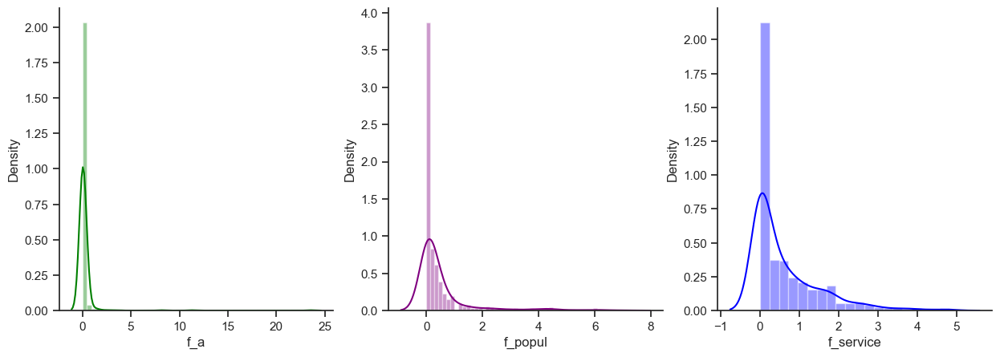

In [80]:
# Plotting the KDE Plot f_popul	f_service	f_a
_,axs=plt.subplots(1,3,figsize=(15,5))
plt.subplot(1,3,1)
axs[0]=sns.distplot(osm_data_by_group["f_a"],color="green")


plt.subplot(1,3,2)
axs[1]=sns.distplot(osm_data_by_group["f_popul"],color="purple")


plt.subplot(1,3,3)
axs[2]=sns.distplot(osm_data_by_group["f_service"],color="blue")


plt.ylabel('Density')

In [82]:
# create model that fit our data
degree=10
model1=np.poly1d(np.polyfit(osm_data_by_group["dist_station"].values, osm_data_by_group["f_a"].values/osm_data_by_group.f_a.max(), degree))
model2=np.poly1d(np.polyfit(osm_data_by_group["dist_station"].values, osm_data_by_group["f_popul"].values/osm_data_by_group.f_popul.max(), degree))
model3=np.poly1d(np.polyfit(osm_data_by_group["dist_station"].values, osm_data_by_group["f_service"].values/osm_data_by_group.f_service.max(), degree))
model4=np.poly1d(np.polyfit(osm_data_by_group["dist_station"].values, osm_data_by_group["f_secu"].values/osm_data_by_group.f_secu.max(), degree))

In [83]:
# extrapolate values from those models
yp1 = np.polyval(model1,osm_data_by_group["dist_station"].values)
yp2 = np.polyval(model2,osm_data_by_group["dist_station"].values)
yp3 = np.polyval(model3,osm_data_by_group["dist_station"].values)
yp4= np.polyval(model4,osm_data_by_group["dist_station"].values)

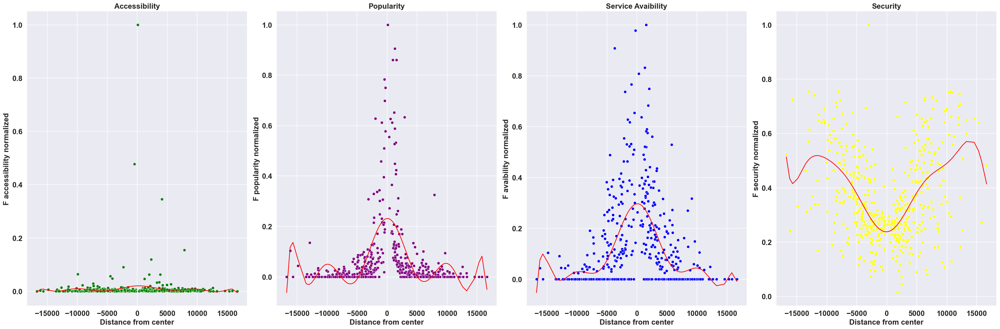

In [84]:
# plot the result
plt.rcParams['figure.figsize'] = [10, 3]
plt.rcParams['figure.dpi'] = 100 # 200 e.g. is really fine, but slower
font = {'family' : 'DejaVu Sans',
        'weight' : 'bold',
        'size'   : 18}
sns.set_theme()

_,axs=plt.subplots(1,4,figsize=(30,10))
plt.subplot(1,4,1)
axs[0]=sns.scatterplot(x=osm_data_by_group["dist_station"],y=osm_data_by_group["f_a"]/osm_data_by_group.f_a.max(),color="green")
axs[0]=sns.lineplot(osm_data_by_group.reset_index()["dist_station"], yp1,color='red')
plt.xticks(fontweight="bold",fontsize=16)
plt.yticks(fontweight="bold",fontsize=16)
plt.xlabel('Distance from center',fontweight="bold",fontsize=16)
plt.ylabel('F accessibility normalized',fontweight="bold",fontsize=16)
plt.title('Accessibility',fontweight="bold",fontsize=16)
plt.subplot(1,4,2)
axs[1]=sns.scatterplot(x=osm_data_by_group["dist_station"],y=osm_data_by_group["f_popul"]/osm_data_by_group.f_popul.max(),color="purple")
axs[1]=sns.lineplot(osm_data_by_group.reset_index()["dist_station"], yp2,color='red')
plt.xticks(fontweight="bold",fontsize=16)
plt.yticks(fontweight="bold",fontsize=16)
plt.xlabel('Distance from center',fontweight="bold",fontsize=16)
plt.ylabel('F popularity normalized',fontweight="bold",fontsize=16)
plt.title('Popularity',fontweight="bold",fontsize=16)
plt.subplot(1,4,3)
axs[2]=sns.scatterplot(x=osm_data_by_group["dist_station"],y=osm_data_by_group["f_service"]/osm_data_by_group.f_service.max(),color="blue")
axs[2]=sns.lineplot(osm_data_by_group.reset_index()["dist_station"], yp3,color='red')
plt.xticks(fontweight="bold",fontsize=16)
plt.yticks(fontweight="bold",fontsize=16)
plt.xlabel('Distance from center',fontweight="bold",fontsize=16)
plt.ylabel('F avaibility normalized',fontweight="bold",fontsize=16)
plt.title('Service Avaibility',fontweight="bold",fontsize=16)

plt.subplot(1,4,4)
axs[3]=sns.scatterplot(x=osm_data_by_group["dist_station"],y=osm_data_by_group["f_secu"]/osm_data_by_group.f_secu.max(),color="yellow")
axs[3]=sns.lineplot(osm_data_by_group.reset_index()["dist_station"], yp4,color='red')
plt.xticks(fontweight="bold",fontsize=16)
plt.yticks(fontweight="bold",fontsize=16)
plt.xlabel('Distance from center',fontweight="bold",fontsize=16)
plt.ylabel('F security normalized',fontweight="bold",fontsize=16)
plt.title('Security',fontweight="bold",fontsize=16)
plt.tight_layout()
plt.savefig("Figures/png/station_analysis.png")
plt.show()